# Imports

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
import time
import math

import torch
import torch.nn.functional as F
from torch import nn, Tensor

# Importing our existing flow funcs
import os
import sys
from pathlib import Path
# Add parent directory to sys.path
parent_dir = Path.cwd().parent.parent
sys.path.append(str(parent_dir))
# Import modules
from analytic_flow_funcs import compute_linear_velocity_batch, forward_euler_integration_analytic_linear

# Distribution Generation

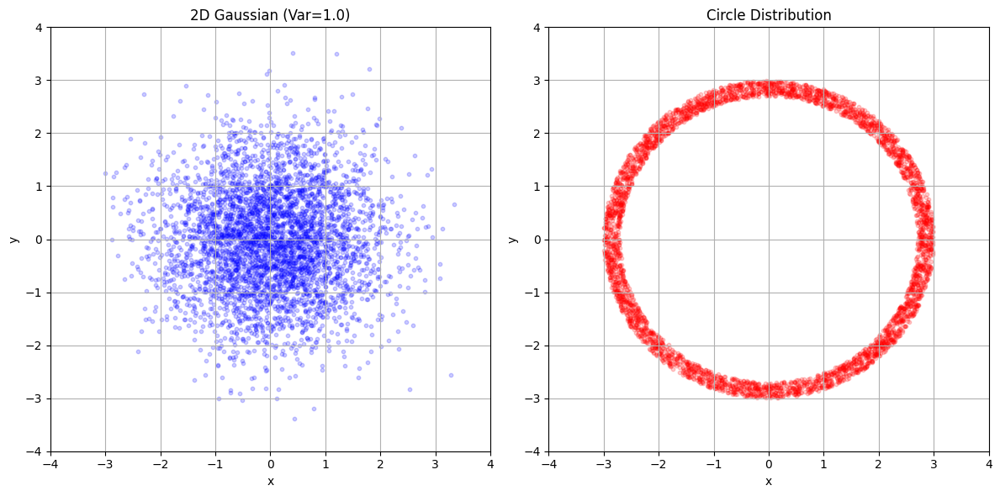

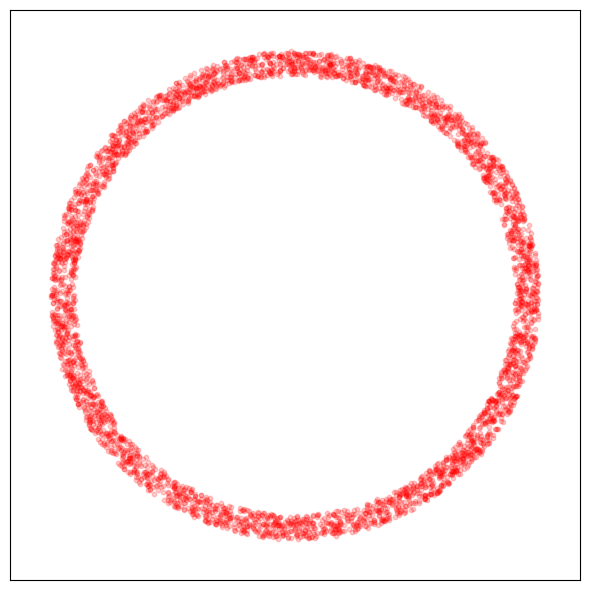

In [5]:
def generate_gaussian(n_dims, num_points, noise_std=1.0):
    """
    Generate an n-dimensional independent Gaussian distribution with specified variance.
    """
    return torch.randn(num_points, n_dims) * (noise_std)

def generate_crescent(num_points, R=1.0, r=0.6, d=0.5):
    """
    Generate a crescent-shaped 2D distribution.
    
    Args:
        num_points: Number of points to generate.
        noise_std: Standard deviation of Gaussian noise (default: 0.03).
        R: Radius of the larger circle (default: 1.0).
        r: Radius of the smaller circle (default: 0.6).
        d: Offset of the smaller circle (default: 0.5).
        
    Returns:
        torch.Tensor of shape (num_points, 2).
    """
    points = []
    while len(points) < num_points:
        # Sample angles non-uniformly to concentrate points near crescent edges
        theta = torch.rand(1).item() * 2 * math.pi
        
        # Sample radii with higher density near the edges of the larger circle
        radius = R * torch.sqrt(torch.rand(1)).item()  # sqrt biases toward edges
        
        # Convert to Cartesian coordinates
        x = radius * math.cos(theta)
        y = radius * math.sin(theta)
        
        # Check if point is outside the smaller offset circle
        if (x - d)**2 + y**2 > r**2:
            points.append([x, y])
    
    points = torch.tensor(points[:num_points])
    
    return points

# Generate samples with different variances
sigma_i = 1.0
num_points = 4000
gaussian_samples1 = generate_gaussian(n_dims=2, num_points=num_points, noise_std=sigma_i)  # Default variance
circle_samples = generate_crescent(num_points=num_points, R=3.0, r=2.7, d=0) # No offset guarantees a circle

# Initial and final distributions
initial_dist = gaussian_samples1
final_dist = circle_samples

x_lim_params = (-4, 4)
y_lim_params = (-4, 4)

# Plot the distributions
plt.figure(figsize=(12, 6))

# Plot Gaussian distribution with variance=1.0
plt.subplot(1, 2, 1)
plt.scatter(initial_dist[:, 0].numpy(), initial_dist[:, 1].numpy(), 
            c='blue', alpha=0.2, s=10)
plt.title('2D Gaussian (Var=1.0)')
plt.xlabel('x')
plt.ylabel('y')
plt.xlim(x_lim_params)  
plt.ylim(y_lim_params)  
plt.grid(True)

# Plot Spiral distribution
plt.subplot(1, 2, 2)
plt.scatter(final_dist[:, 0].numpy(), final_dist[:, 1].numpy(), 
            c='red', alpha=0.2, s=10)
plt.title('Circle Distribution')
plt.xlabel('x')
plt.ylabel('y')
plt.xlim(x_lim_params)  
plt.ylim(y_lim_params)  
plt.grid(True)

plt.tight_layout()
plt.show()

plt.figure(figsize=(6, 6))
plt.scatter(final_dist[:, 0].numpy(), final_dist[:, 1].numpy(), 
            c='red', alpha=0.2, s=10)
plt.xlim((-3.5, 3.5))  
plt.ylim((-3.5, 3.5))
plt.xticks([])  # Remove x-axis ticks
plt.yticks([])  # Remove y-axis ticks
plt.grid(True)
plt.tight_layout()
plt.savefig("imgs/circle.png")

# Using The Analytical Flow

In [3]:
# Run integration
start_time = time.time()

trajectory = forward_euler_integration_analytic_linear(
    initial_points=initial_dist,
    data=final_dist,
    t_start=0.0,
    t_end=1.0, 
    num_steps=100,
    sigma_i=sigma_i
)

# Calculate elapsed time
elapsed_time = time.time() - start_time
print(f"Integration completed in {elapsed_time:.4f} seconds")


Integration completed in 38.0918 seconds


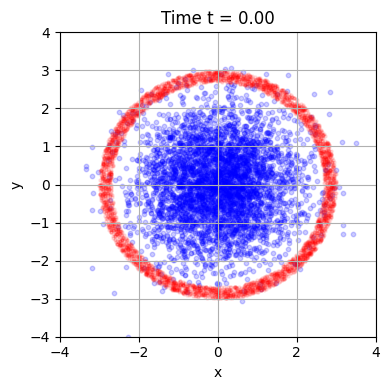

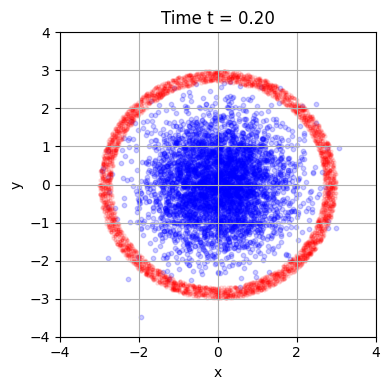

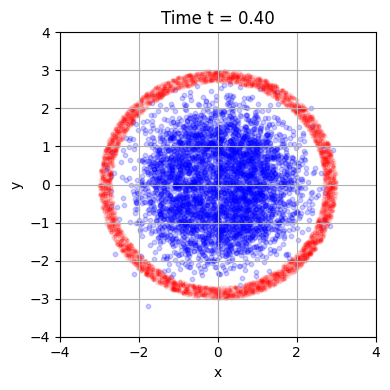

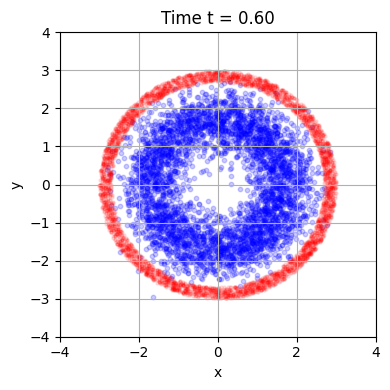

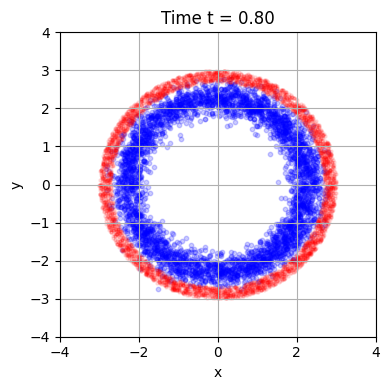

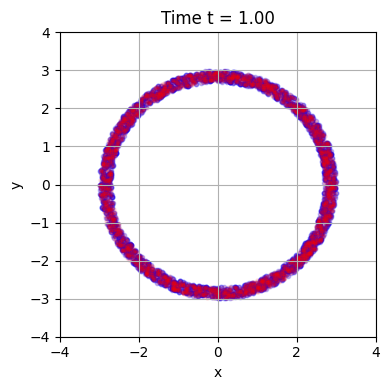

In [4]:
steps_to_plot = [0, 20, 40, 60, 80, 100]
for i, step in enumerate(steps_to_plot):
    current_time = step/max(steps_to_plot)
    current_points = trajectory[step]
    
    plt.figure(figsize=(4, 4))
    plt.scatter(current_points[:, 0].numpy(), current_points[:, 1].numpy(),
               c='blue', alpha=0.2, s=10, label='Current Points')
    plt.scatter(final_dist[:, 0].numpy(), final_dist[:, 1].numpy(),
               c='red', alpha=0.1, s=5, label='Target Distribution')
    
    plt.title(f'Time t = {current_time:.2f}')
    plt.xlabel('x')
    plt.ylabel('y')
    plt.xlim(x_lim_params)  
    plt.ylim(y_lim_params)  
    plt.grid(True)    
    plt.tight_layout()
    plt.show()

## Animated GIF

In [5]:
def animate_trajectory(trajectory, final_dist):
    fig, ax = plt.subplots(figsize=(5,5))
    
    # Initialize scatter plots
    current_scatter = ax.scatter([], [], c='blue', alpha=0.2, s=10, label='Current Points')
    target_scatter = ax.scatter(final_dist[:, 0], final_dist[:, 1], c='red', alpha=0.1, s=5, label='Target Distribution')
    
    ax.set_xlim(x_lim_params)
    ax.set_ylim(y_lim_params)
    ax.grid(True)
    ax.legend()
    
    def update(frame):
        current_scatter.set_offsets(trajectory[frame])
        ax.set_title(f'Time t = {frame/(len(trajectory)-1):.2f}')
        return current_scatter,
    
    ani = FuncAnimation(fig, update, frames=len(trajectory), interval=50, blit=True)
    plt.close()
    return ani

os.makedirs('imgs', exist_ok=True)

# Create animation and save
start_time = time.time()
ani = animate_trajectory(trajectory.numpy(), final_dist.numpy())
ani.save('imgs/flow_matching_analytic.gif', writer='pillow', fps=20, dpi=80)
# Calculate elapsed time
elapsed_time = time.time() - start_time
print(f"Gif made in {elapsed_time:.4f} seconds")

# To display in Jupyter notebook:
from IPython.display import HTML
HTML(ani.to_jshtml())

Gif made in 23.1891 seconds


# Machine Learning Solution

## Training

In [6]:
# Define the Flow model
class Flow(nn.Module):
    def __init__(self, dim: int = 2, h: int = 128):
        super().__init__()
        self.net = nn.Sequential(
            nn.Linear(dim + 1, h), nn.SiLU(),
            nn.Linear(h, h), nn.SiLU(),
            nn.Linear(h, h), nn.SiLU(),
            nn.Linear(h, h), nn.SiLU(),
            nn.Linear(h, dim))
    
    def forward(self, t: Tensor, x_t: Tensor) -> Tensor:
        return self.net(torch.cat((t, x_t), -1))

# Set device at the beginning (once)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Initialize model and optimizer
flow = Flow().to(device)
optimizer = torch.optim.AdamW(flow.parameters(), lr=1e-3)
loss_fn = nn.MSELoss()

# Training loop
batch_size = 2048
n_epochs = 30000

initial_dist_ml = initial_dist.to(device)
final_dist_ml = final_dist.to(device)

# Training loop with device awareness
start_time = time.time()
for epoch in range(n_epochs):
    # Random batch indices - created on target device directly
    idx_0 = torch.randperm(num_points, device=device)[:batch_size]  # Input indices
    idx_1 = torch.randperm(num_points, device=device)[:batch_size]  # Output indices
    
    x_0 = initial_dist_ml[idx_0]  # Random batch from input distribution
    x_1 = final_dist_ml[idx_1]  # Random batch from output distribution
    
    # Random time points - created on target device
    t = torch.rand(batch_size, 1, device=device)
    
    x_t = (1 - t) * x_0 + t * x_1
    dx_t = x_1 - x_0
    
    # Forward pass
    optimizer.zero_grad()
    pred = flow(t, x_t)  # Model is on device
    loss = loss_fn(pred, dx_t)
    loss.backward()
    optimizer.step()
    
    if epoch % 2000 == 0:
        print(f"Epoch {epoch}, Loss: {loss.item():.4f}")

elapsed_time = time.time() - start_time
print(f"Training completed in {elapsed_time:.4f} seconds")

Epoch 0, Loss: 5.1490
Epoch 2000, Loss: 2.7639
Epoch 4000, Loss: 2.6173
Epoch 6000, Loss: 2.6889
Epoch 8000, Loss: 2.5848
Epoch 10000, Loss: 2.6801
Epoch 12000, Loss: 2.6562
Epoch 14000, Loss: 2.7132
Epoch 16000, Loss: 2.7155
Epoch 18000, Loss: 2.7388
Epoch 20000, Loss: 2.6495
Epoch 22000, Loss: 2.5764
Epoch 24000, Loss: 2.7121
Epoch 26000, Loss: 2.7086
Epoch 28000, Loss: 2.7045
Training completed in 100.8932 seconds


## Visualization

In [7]:
def forward_euler_integration_model(
    initial_points: torch.Tensor,  # [m, d]
    flow_model: nn.Module,          # Trained Flow model
    t_start: float = 0.0,           # Typically 0
    t_end: float = 1.0,             # Typically 1
    num_steps: int = 100,           # Integration steps
    save_trajectory: bool = True    # Whether to store full trajectory
) -> torch.Tensor:

    dt = (t_end - t_start) / num_steps
    current_points = initial_points.clone()
    
    if save_trajectory:
        trajectory = torch.zeros(num_steps + 1, *initial_points.shape, 
                               device=initial_points.device)
        trajectory[0] = current_points.clone()
    
    current_time = t_start
    
    for step in range(1, num_steps + 1):
        # Compute velocity from learned model
        with torch.no_grad():  # Disable gradients for integration
            t_tensor = torch.full((current_points.shape[0], 1), current_time,
                                device=current_points.device)
            velocity = flow_model(t_tensor, current_points)
        
        # Euler update
        current_points = current_points + velocity * dt
        current_time = current_time + dt
        
        if save_trajectory:
            trajectory[step] = current_points.clone()
    
    return trajectory if save_trajectory else current_points

In [8]:
start_time = time.time()

trajectory_model = forward_euler_integration_model(
    initial_points=initial_dist_ml,
    flow_model=flow,
    t_start=0.0,
    t_end=1.0,
    num_steps=100
)

# Calculate elapsed time
elapsed_time = time.time() - start_time
print(f"Integration completed in {elapsed_time:.4f} seconds")

Integration completed in 0.0645 seconds


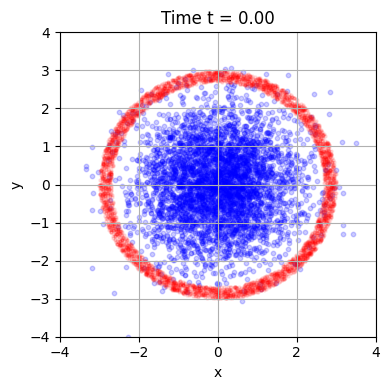

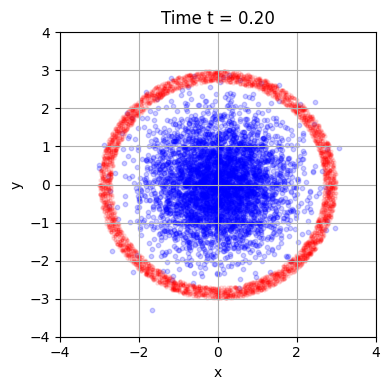

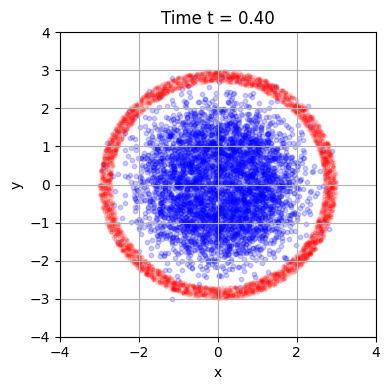

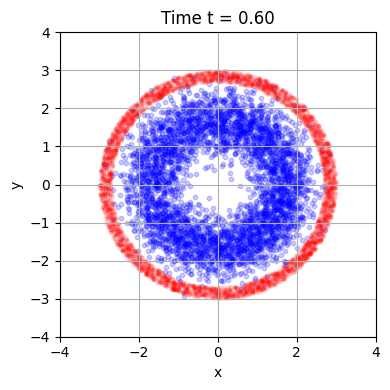

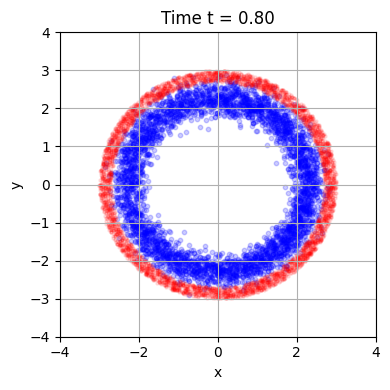

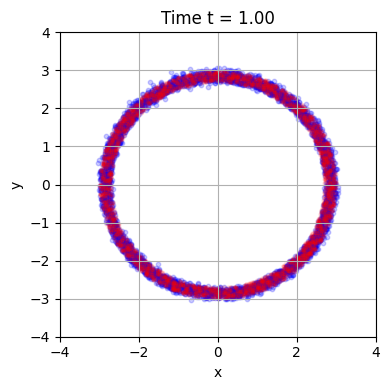

In [9]:
steps_to_plot = [0, 20, 40, 60, 80, 100]
for i, step in enumerate(steps_to_plot):
    current_time = step/max(steps_to_plot)
    current_points = trajectory_model[step]
    
    plt.figure(figsize=(4, 4))
    plt.scatter(current_points[:, 0].cpu().numpy(), current_points[:, 1].cpu().numpy(),
               c='blue', alpha=0.2, s=10, label='Current Points')
    plt.scatter(final_dist[:, 0].numpy(), final_dist[:, 1].numpy(),
               c='red', alpha=0.1, s=5, label='Target Distribution')
    
    plt.title(f'Time t = {current_time:.2f}')
    plt.xlabel('x')
    plt.ylabel('y')
    plt.xlim(x_lim_params)  
    plt.ylim(y_lim_params)  
    plt.grid(True)    
    plt.tight_layout()
    plt.show()

## Animated GIF - Machine Learning

In [10]:
def animate_trajectory(trajectory, final_dist):
    fig, ax = plt.subplots(figsize=(5,5))
    
    # Initialize scatter plots
    current_scatter = ax.scatter([], [], c='blue', alpha=0.2, s=10, label='Current Points')
    target_scatter = ax.scatter(final_dist[:, 0], final_dist[:, 1], c='red', alpha=0.1, s=5, label='Target Distribution')
    
    ax.set_xlim(x_lim_params)
    ax.set_ylim(y_lim_params)
    ax.grid(True)
    ax.legend()
    
    def update(frame):
        current_scatter.set_offsets(trajectory[frame])
        ax.set_title(f'Time t = {frame/(len(trajectory)-1):.2f}')
        return current_scatter,
    
    ani = FuncAnimation(fig, update, frames=len(trajectory), interval=50, blit=True)
    plt.close()
    return ani

# Create animation
start_time = time.time()
ani = animate_trajectory(trajectory_model.cpu().numpy(), final_dist.numpy())
# Or to save as GIF:
ani.save('imgs/flow_matching_model.gif', writer='pillow', fps=20, dpi=80)
# Calculate elapsed time
elapsed_time = time.time() - start_time
print(f"Gif made in {elapsed_time:.4f} seconds")

# To display in Jupyter notebook:
from IPython.display import HTML
HTML(ani.to_jshtml())

Gif made in 23.3735 seconds


# Theoretical Minimum Loss

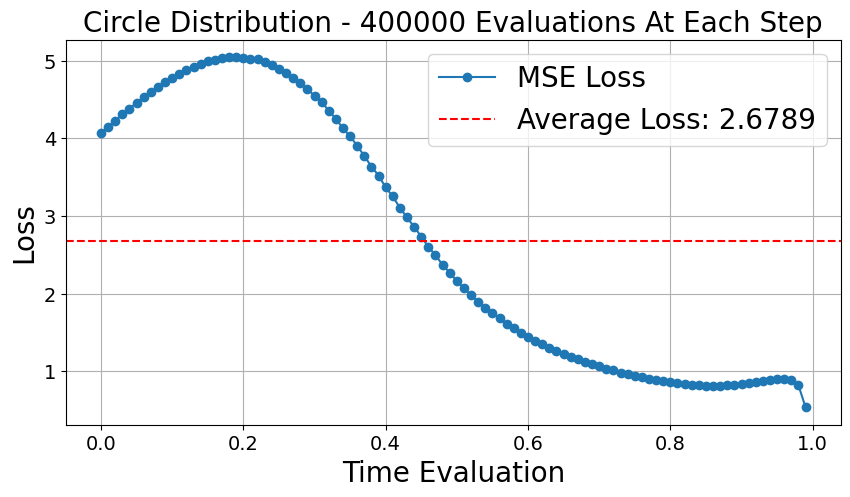

The average loss for our optimal velocity field was  2.678900371193886


In [11]:
# Initialize storage for losses
time_points = np.arange(0, 1.0, 0.01)
losses = np.zeros(len(time_points))  # Store average losses
n_trials = 100  # Number of trials to average over at each time point

for i, time_eval in enumerate(time_points):
    trial_losses = []
    
    for _ in range(n_trials):
        # Random batch indices
        idx_0 = torch.randperm(num_points, device=device)
        idx_1 = torch.randperm(num_points, device=device)
        
        x_0 = initial_dist_ml[idx_0]
        x_1 = final_dist_ml[idx_1]
        
        # Fixed time points
        t = torch.full((num_points, 1), time_eval, device=device)
        
        x_t = (1 - t) * x_0 + t * x_1
        dx_t = x_1 - x_0
        
        # Forward pass
        pred = compute_linear_velocity_batch(x_t, final_dist_ml, time_eval, sigma_i)
        loss = loss_fn(pred, dx_t)
        trial_losses.append(loss.detach().cpu().numpy())
    
    # Store average loss for this time point
    losses[i] = np.mean(trial_losses)

# Convert to numpy array
losses = np.array(losses)

# Plotting
plt.figure(figsize=(10, 5))
plt.plot(time_points, losses, 'o-', label='MSE Loss')
plt.xlabel('Time Evaluation', fontsize = 20)
plt.ylabel('Loss', fontsize = 20)
plt.title(f'Circle Distribution - {n_trials*num_points} Evaluations At Each Step', fontsize = 20)
plt.grid(True)

# Add average loss line
avg_loss = np.mean(losses)
plt.axhline(avg_loss, color='r', linestyle='--', label=f'Average Loss: {avg_loss:.4f}')
plt.tick_params(axis='both', which='major', labelsize=14) 
plt.legend(fontsize = 20)
plt.savefig('imgs/loss_circle.png', bbox_inches='tight', dpi=300) 
plt.show()

print ("The average loss for our optimal velocity field was ", avg_loss)